<div style="background-color:#ddffcc; padding:10px;">

<div style="text-align: center"><h1> Diabetes prediction <h1>
  


<div style="background-color:#ddffcc; padding:10px;">

<span style="font-size:24px; font-weight:bold;">Introduction </span> <br>
Diabetes is a chronic disease that affects millions of people worldwide. Early detection is crucial to prevent complications and manage the disease effectively. In this project, we will be building a machine learning model that can predict whether a person has diabetes based on several features such as age, gender, hypertension, heart disease, smoking history, BMI, HbA1c level, and blood glucose level.
</div>

<div style="background-color:#ddffcc; padding:10px;">
<span style="font-size:24px; font-weight:bold;">About Dataset </span> <br>
The Diabetes prediction dataset is a collection of medical and demographic data from patients, along with their diabetes status (positive or negative). The data includes features such as age, gender, body mass index (BMI), hypertension, heart disease, smoking history, HbA1c level, and blood glucose level. 
    This dataset can be used to build machine learning models to predict diabetes in patients based on their medical history and demographic information. This can be useful for healthcare professionals in identifying patients who may be at risk of developing diabetes and in developing personalized treatment plans. 

<div style="background-color:#ddffcc; padding:10px;">
<span style="font-size:24px; font-weight:bold;">Feature explanation </span> <br>
    
**age** - Age is an important factor as diabetes is more commonly diagnosed in older adults.Age ranges from 0-80 in our dataset. <br> 
    
**gender** - Gender refers to the biological sex of the individual, which can have an impact on their susceptibility to diabetes.<br>
    
**body mass index (BMI)** -BMI (Body Mass Index) is a measure of body fat based on weight and height. Higher BMI values are linked to a higher risk of diabetes. The range of BMI in the dataset is from 10.16 to 71.55. BMI less than 18.5 is underweight, 18.5-24.9 is normal, 25-29.9 is overweight, and 30 or more is obese. <br>
    
**hypertension** - Hypertension is a medical condition in which the blood pressure in the arteries is persistently elevated. It has values a 0 or 1 where 0 indicates they don’t have hypertension and for 1 it means they have hypertension.<br>
    
**heart disease** - Heart disease is another medical condition that is associated with an increased risk of developing diabetes. It has values a 0 or 1 where 0 indicates they don’t have heart disease and for 1 it means they have heart disease. <br>
    
**smoking history** - Smoking history is also considered a risk factor for diabetes and can exacerbate the complications associated with diabetes.In our dataset we have 5 categories i.e not current,former,No Info,current,never and ever. <br>
    
**HbA1c level** - HbA1c (Hemoglobin A1c) level is a measure of a person's average blood sugar level over the past 2-3 months. Higher levels indicate a greater risk of developing diabetes. Mostly more than 6.5% of HbA1c Level indicates diabetes. <br>
    

**blood glucose level**  - Blood glucose level refers to the amount of glucose in the bloodstream at a given time. High blood glucose levels are a key indicator of diabetes.

  

In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")
from numpy import where
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from io import StringIO
import pydot

from IPython.display import Image
from sklearn.model_selection import train_test_split as split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import cross_val_score, KFold
import warnings
from sklearn.metrics import log_loss



import warnings
warnings.filterwarnings("ignore")



In [2]:
! pip install imblearn
!pip install graphviz


In [3]:
import imblearn
from imblearn.metrics import specificity_score

In [4]:
import pydot
import graphviz

# Check if pydot is installed
print(pydot.__version__)

# Check if Graphviz is installed
print(graphviz.__version__)

1.4.2
0.20.1


In [5]:
df=pd.read_csv(r'diabetes_prediction_dataset.csv')
print(df.shape)
df.head()

(100000, 9)


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   gender               100000 non-null  object 
 1   age                  100000 non-null  float64
 2   hypertension         100000 non-null  int64  
 3   heart_disease        100000 non-null  int64  
 4   smoking_history      100000 non-null  object 
 5   bmi                  100000 non-null  float64
 6   HbA1c_level          100000 non-null  float64
 7   blood_glucose_level  100000 non-null  int64  
 8   diabetes             100000 non-null  int64  
dtypes: float64(3), int64(4), object(2)
memory usage: 6.9+ MB


### Are there missing values?

In [7]:

df.isnull().sum()

gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes               0
dtype: int64

In [8]:
df.nunique()

gender                    3
age                     102
hypertension              2
heart_disease             2
smoking_history           6
bmi                    4247
HbA1c_level              18
blood_glucose_level      18
diabetes                  2
dtype: int64

### Clean class "other" from gender

In [9]:
#Count the number of each category in gender
male_count = (df['gender']=='Male').sum()
female_count = (df['gender']=='Female').sum()
other_count = (df['gender']=='Other').sum()

print("Male count:", male_count, "Female count:", female_count, "Other count:", other_count)

Male count: 41430 Female count: 58552 Other count: 18


In [10]:
#clean the other class from gender feature
df=df[df['gender']!='Other']
df.shape

(99982, 9)

### Does the data has duplicates?

In [11]:
# Are there duplicate rows?
duplicated_sum = df.duplicated().sum()
print(f"No of Duplicate rows: {duplicated_sum} ")

#Clean duplicated rows
df=df.drop_duplicates()
df.shape

No of Duplicate rows: 3854 


(96128, 9)

In [12]:
df.columns


Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes'],
      dtype='object')

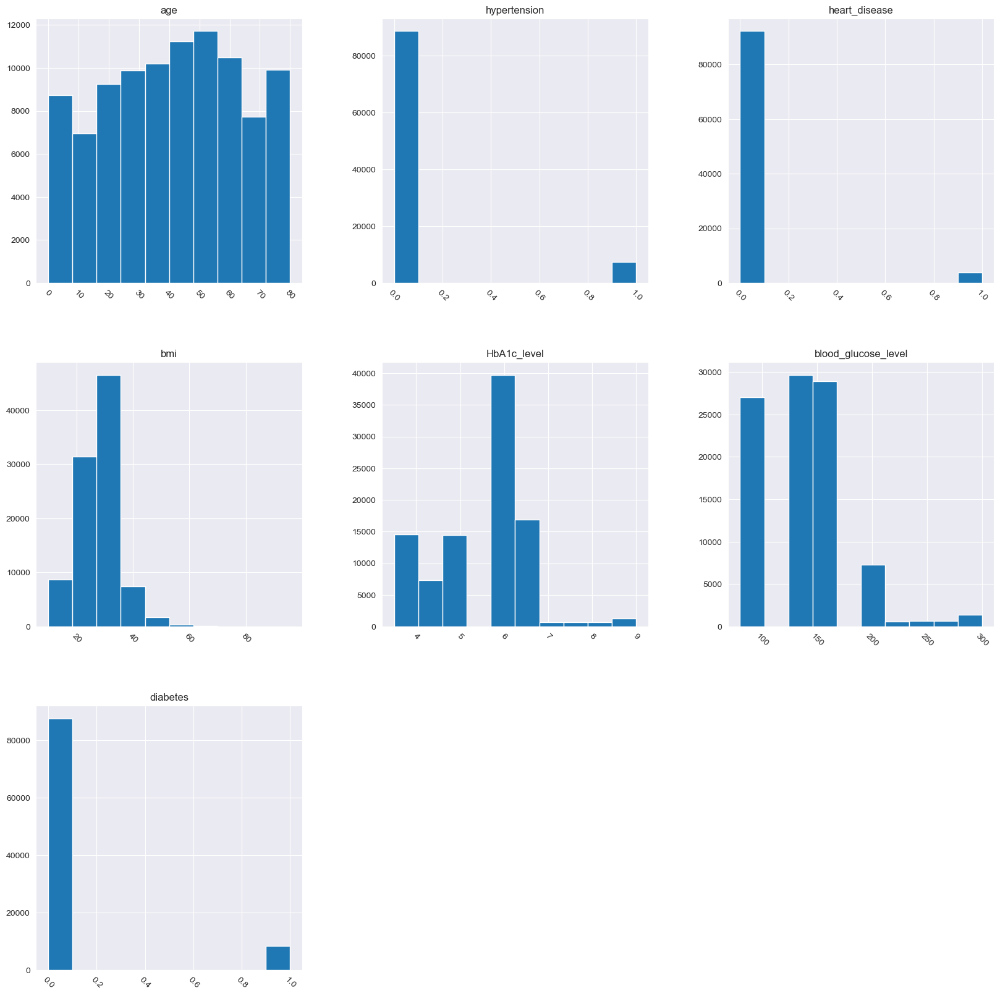

In [13]:
df.hist(figsize=(20,20), xrot=-45)
plt.show()

<Axes: >

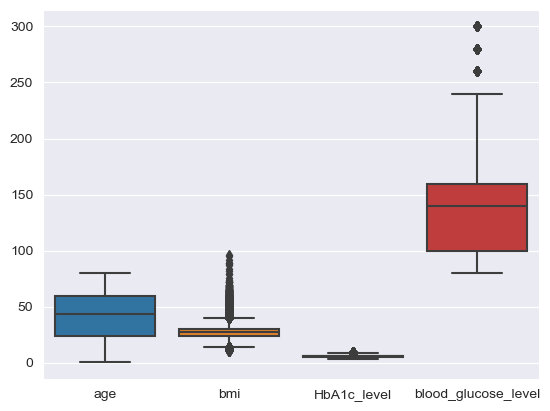

In [14]:
#Do we have outliers in the numerical features?
sns.boxplot(data=df[['age', 'bmi', 'HbA1c_level','blood_glucose_level']])

#We do have outliers in BMI and Blood glucose level, lets look at them

In [15]:
blood_glucose_uniqe=df['blood_glucose_level'].unique()
blood_glucose_uniqe

array([140,  80, 158, 155,  85, 200, 145, 100, 130, 160, 126, 159,  90,
       260, 220, 300, 280, 240], dtype=int64)

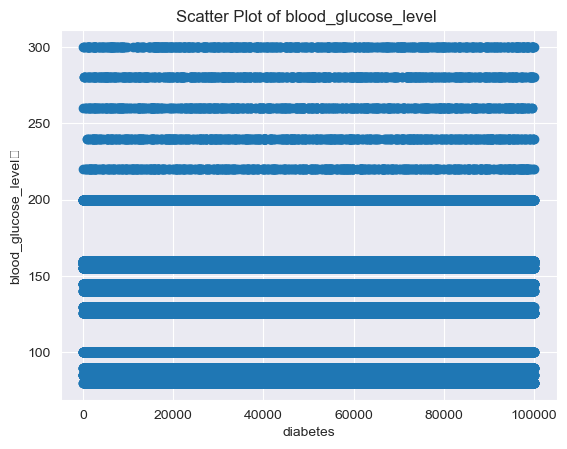

In [16]:
plt.scatter(df.index, df['blood_glucose_level'])
plt.xlabel('diabetes')
plt.ylabel('blood_glucose_level	')
plt.title('Scatter Plot of blood_glucose_level ')
plt.show()
# In blood glucose levels the values are not outlyers - there are 18 categories of values. 

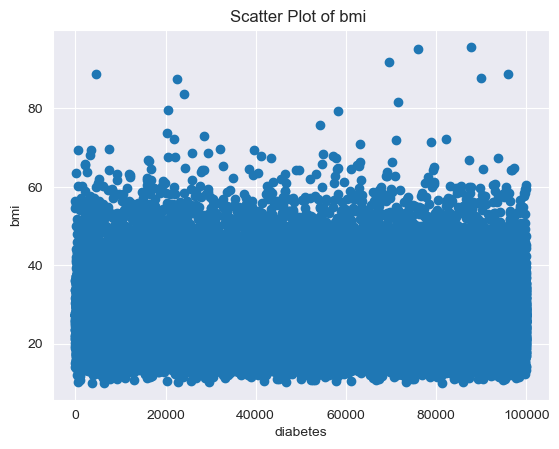

In [17]:
plt.scatter(df.index, df['bmi'])
plt.xlabel('diabetes')
plt.ylabel('bmi')
plt.title('Scatter Plot of bmi ')
plt.show()

### Categorical vs numerical features

In [18]:
cat_columns=df.select_dtypes(['object']).columns
print(cat_columns)
num_columns=df.select_dtypes(['number']).columns
print(num_columns)

Index(['gender', 'smoking_history'], dtype='object')
Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes'],
      dtype='object')


In [19]:
num_df=df.select_dtypes(include = np.number)
num_df.head()

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes
0,80.0,0,1,25.19,6.6,140,0
1,54.0,0,0,27.32,6.6,80,0
2,28.0,0,0,27.32,5.7,158,0
3,36.0,0,0,23.45,5.0,155,0
4,76.0,1,1,20.14,4.8,155,0


In [20]:
num_cols = list(set(df._get_numeric_data()))

cat_cols = list(set(df.columns) - set(df._get_numeric_data())) # list of categorical columns

for col in cat_cols:
    print('Unique categories',col, set(df[col]))
    

Unique categories gender {'Female', 'Male'}
Unique categories smoking_history {'not current', 'No Info', 'never', 'ever', 'current', 'former'}


## Visualizations

In [21]:
fig = px.scatter_matrix(num_df,
    dimensions=['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level','blood_glucose_level', 'diabetes'],
    color="diabetes",
    title = 'Scatter Matrix',
    width = 1400,
    height = 1200,
    opacity = 0.2)
fig.show()

#### In some categories we can see quite a good separation between the 2 classes

In [22]:
# What is the percentage of people with diabetes?

diabetes_counts=df['diabetes'].value_counts()
# create the pie chart
fig = go.Figure(data=[go.Pie(labels=['No Diabetes', 'Diabetes'], values=diabetes_counts)])

# update the layout
fig.update_layout(title='Diabetes Distribution')

# show the plot
fig.show()

#### The data is imbalanced

### Look only on the diabetes ==1 patients

In [23]:
diabetes=df[df['diabetes']==1]
print(diabetes.shape)
diabetes


(8482, 9)


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
6,Female,44.0,0,0,never,19.31,6.5,200,1
26,Male,67.0,0,1,not current,27.32,6.5,200,1
38,Male,50.0,1,0,current,27.32,5.7,260,1
40,Male,73.0,0,0,former,25.91,9.0,160,1
53,Female,53.0,0,0,former,27.32,7.0,159,1
...,...,...,...,...,...,...,...,...,...
99935,Female,65.0,1,1,never,33.55,8.2,140,1
99938,Male,55.0,0,1,former,30.42,6.2,300,1
99957,Female,61.0,0,0,No Info,34.45,6.5,280,1
99962,Female,58.0,1,0,never,38.31,7.0,200,1


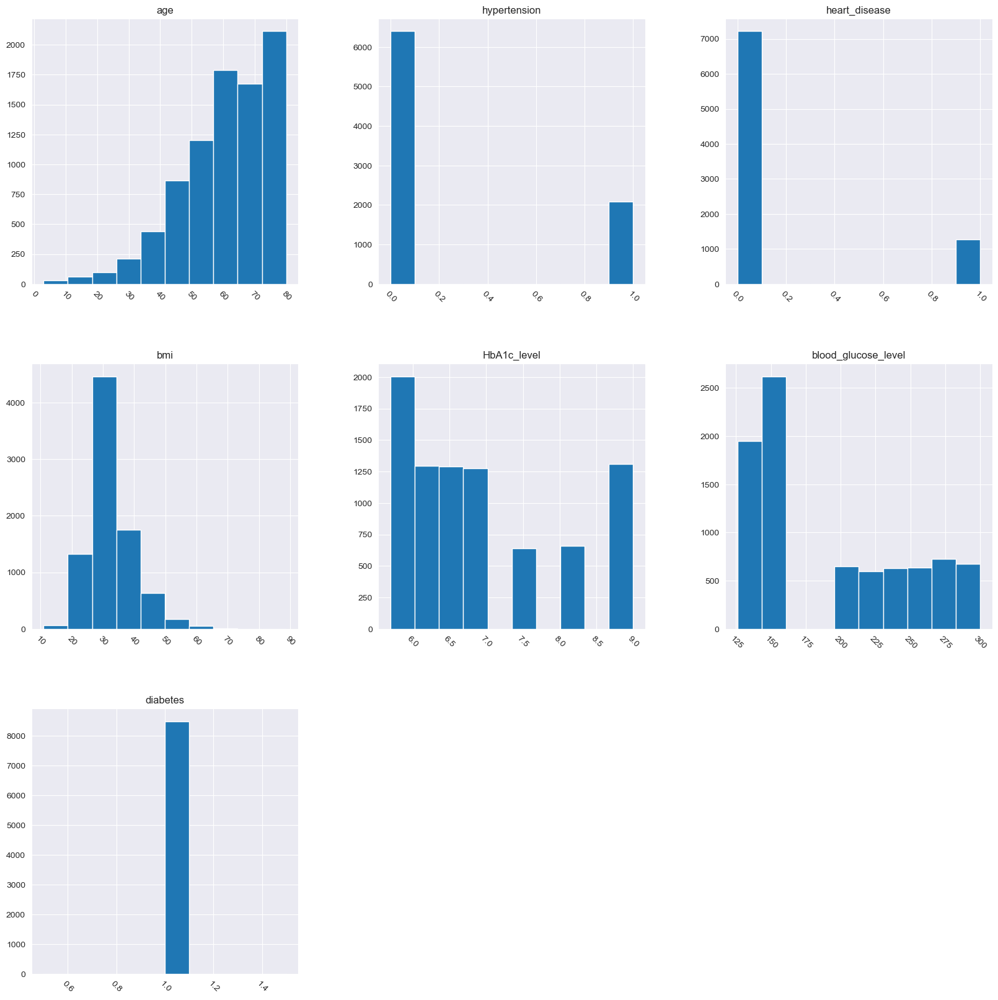

In [24]:
diabetes.hist(figsize=(20,20), xrot=-45)
plt.show()

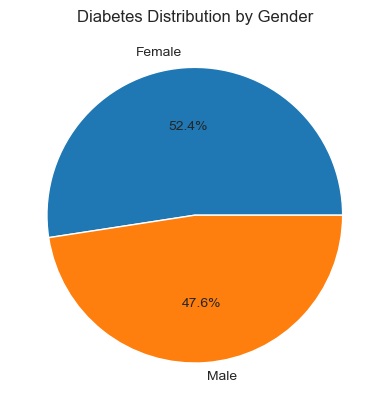

In [25]:
# Is the % of diabetes higher in male or female?

# count the number of males and females with diabetes
diabetes_counts = df[df['diabetes'] == 1]['gender'].value_counts()

# create a pie plot
plt.pie(diabetes_counts, labels=diabetes_counts.index, autopct='%1.1f%%')
plt.title('Diabetes Distribution by Gender')
plt.show()

### Is there a difference between genders?

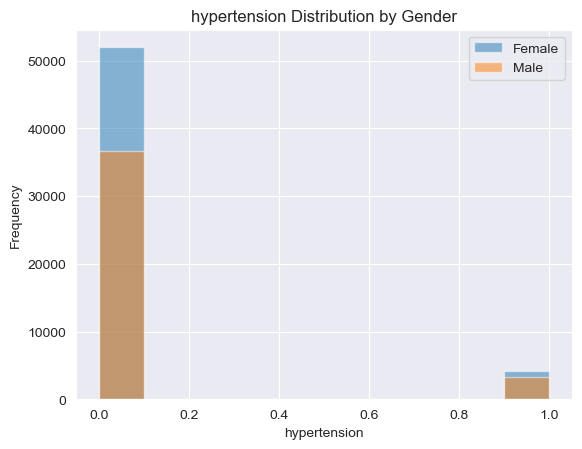

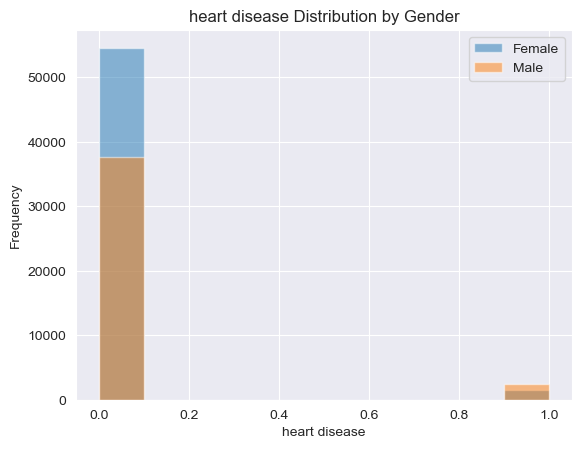

In [26]:
# Groupby the dataframe by 'gender'
grouped_df = df.groupby('gender')

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for gender, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['hypertension'], label=gender, alpha=0.5)

# Customize the plot
ax.set_xlabel('hypertension')
ax.set_ylabel('Frequency')
ax.set_title('hypertension Distribution by Gender')
ax.legend()

# Show the plot
plt.show()


# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for gender, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['heart_disease'], label=gender, alpha=0.5)

# Customize the plot
ax.set_xlabel('heart disease')
ax.set_ylabel('Frequency')
ax.set_title('heart disease Distribution by Gender')
ax.legend()

# Show the plot
plt.show()

#### Males have more heart disease then female.
#### Females have a bit more hypertension


In [27]:
df.columns

Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes'],
      dtype='object')

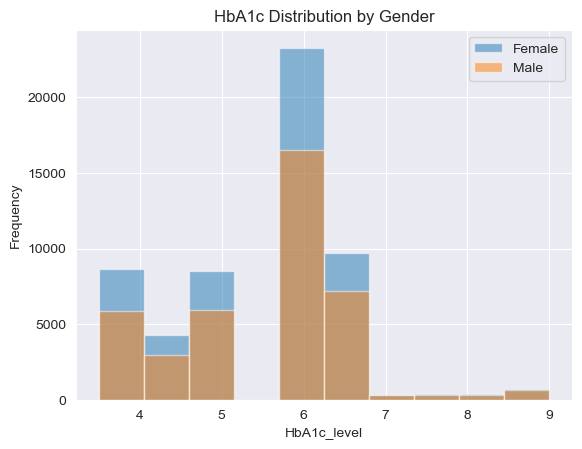

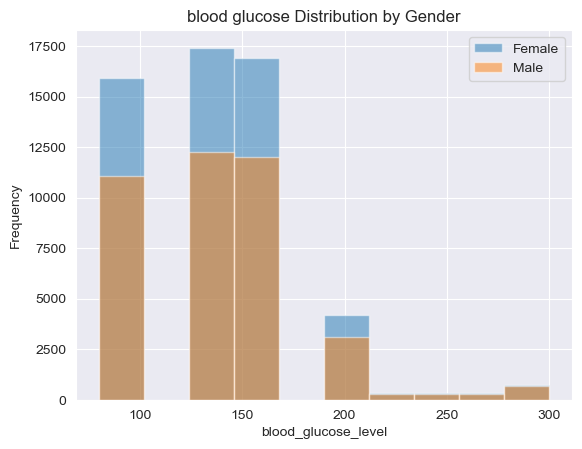

In [28]:

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for gender, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['HbA1c_level'], label=gender, alpha=0.5)

# Customize the plot
ax.set_xlabel('HbA1c_level')
ax.set_ylabel('Frequency')
ax.set_title('HbA1c Distribution by Gender')
ax.legend()

# Show the plot
plt.show()


# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for gender, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['blood_glucose_level'], label=gender, alpha=0.5)

# Customize the plot
ax.set_xlabel('blood_glucose_level')
ax.set_ylabel('Frequency')
ax.set_title('blood glucose Distribution by Gender')
ax.legend()

# Show the plot
plt.show()

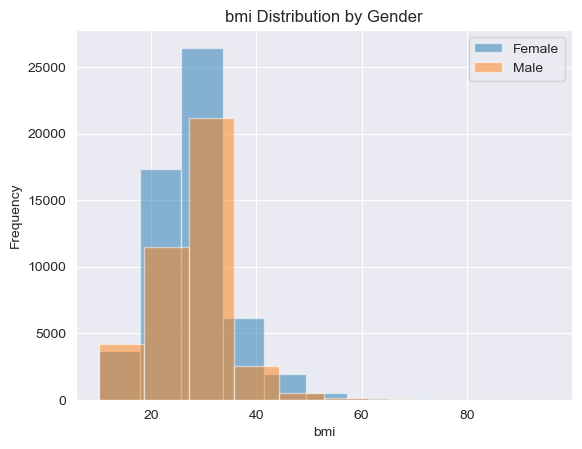

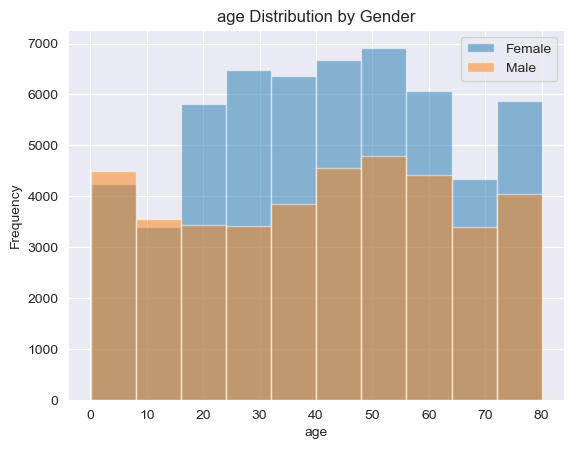

In [29]:
# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for gender, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['bmi'], label=gender, alpha=0.5)

# Customize the plot
ax.set_xlabel('bmi')
ax.set_ylabel('Frequency')
ax.set_title('bmi Distribution by Gender')
ax.legend()

# Show the plot
plt.show()
# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for gender, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['age'], label=gender, alpha=0.5)

# Customize the plot
ax.set_xlabel('age')
ax.set_ylabel('Frequency')
ax.set_title('age Distribution by Gender')
ax.legend()

# Show the plot
plt.show()

#### Females have significantly higher leves of all HbA1c , glucose in blood and bmi


### How smoking effects diabetes?

We now know that smoking is one cause of type 2 diabetes. In fact, people who smoke cigarettes are 30%–40% more likely to develop type 2 diabetes than people who don't smoke.
Based on these we would divide the smoking histry to 3 classes: never , smoke and no info

In [30]:

df['smoking_history'] = df['smoking_history'].replace(['former', 'current', 'not current', 'ever'], 'smoker')

# Verify the updated column
print(df['smoking_history'].value_counts())

never      34395
No Info    32881
smoker     28852
Name: smoking_history, dtype: int64


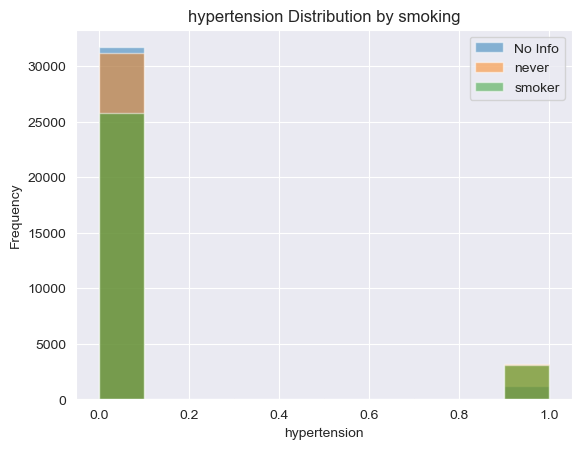

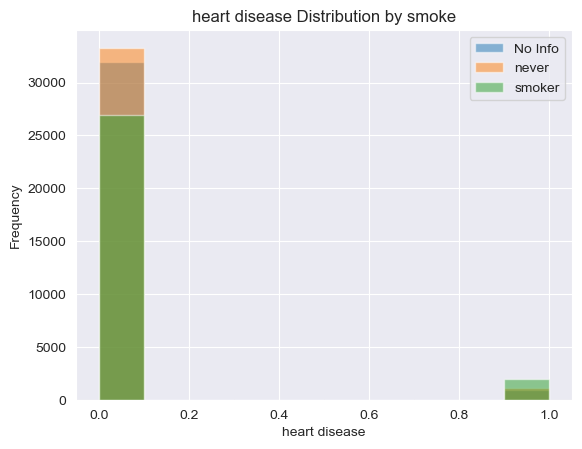

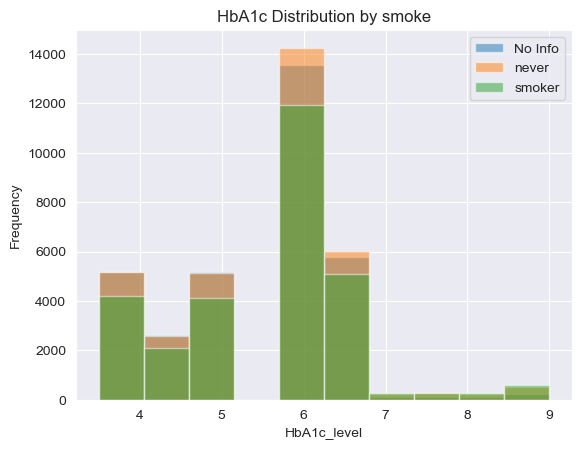

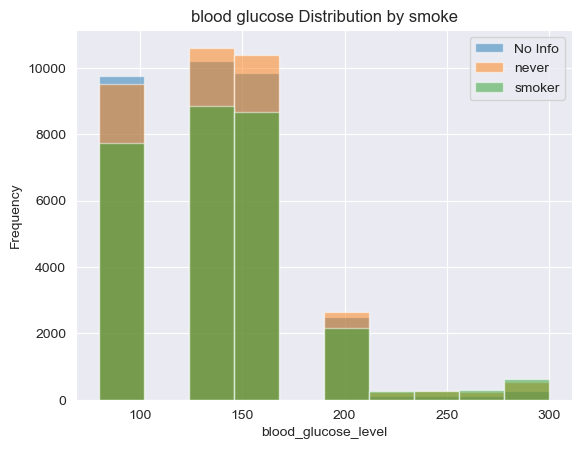

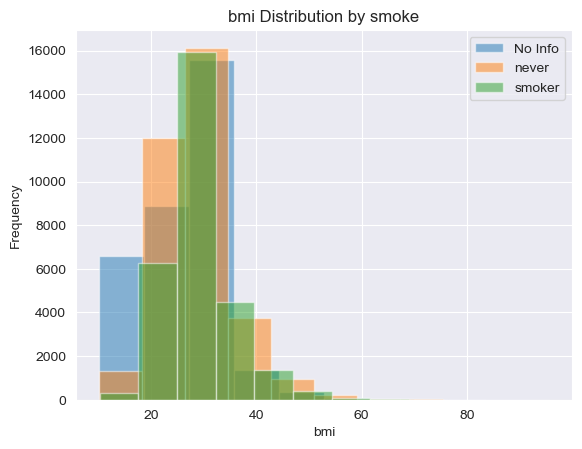

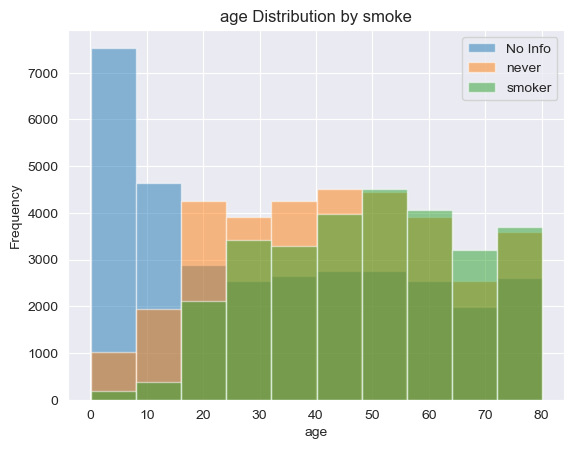

In [31]:
# Groupby the dataframe by 'smoking_history'
grouped_df = df.groupby('smoking_history')

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['hypertension'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('hypertension')
ax.set_ylabel('Frequency')
ax.set_title('hypertension Distribution by smoking')
ax.legend()

# Show the plot
plt.show()

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['heart_disease'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('heart disease')
ax.set_ylabel('Frequency')
ax.set_title('heart disease Distribution by smoke')
ax.legend()

# Show the plot
plt.show()



# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['HbA1c_level'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('HbA1c_level')
ax.set_ylabel('Frequency')
ax.set_title('HbA1c Distribution by smoke')
ax.legend()

# Show the plot
plt.show()


# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['blood_glucose_level'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('blood_glucose_level')
ax.set_ylabel('Frequency')
ax.set_title('blood glucose Distribution by smoke')
ax.legend()

# Show the plot
plt.show()

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['bmi'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('bmi')
ax.set_ylabel('Frequency')
ax.set_title('bmi Distribution by smoke')
ax.legend()

# Show the plot
plt.show()

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['age'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('age')
ax.set_ylabel('Frequency')
ax.set_title('age Distribution by smoke')
ax.legend()

# Show the plot
plt.show()

There is a big portion of "no info" smokers in young ages.
We decided to change the class from "no info" to "never" in all people younger then 12

In [32]:
#Change "no info " to never in children younger than 12 

filtered_df = df[(df['age'] < 12) & (df['smoking_history'] == 'No Info')]
filtered_df.shape


df.loc[df['age'] < 12, 'smoking_history'] = 'never'
df['smoking_history'].value_counts()

never      44080
smoker     28568
No Info    23480
Name: smoking_history, dtype: int64

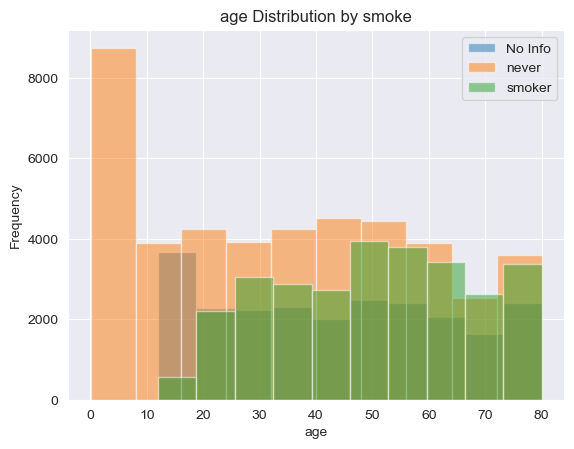

In [33]:
#Age plot after the change
grouped_df = df.groupby('smoking_history')

# Create a single plot
fig, ax = plt.subplots()

# Iterate over each group and plot histograms
for smoke, group in grouped_df:
    # Plot histogram on the same plot
    ax.hist(group['age'], label=smoke, alpha=0.5)

# Customize the plot
ax.set_xlabel('age')
ax.set_ylabel('Frequency')
ax.set_title('age Distribution by smoke')
ax.legend()

# Show the plot
plt.show()

In [34]:
df

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,smoker,23.45,5.0,155,0
4,Male,76.0,1,1,smoker,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99994,Female,36.0,0,0,No Info,24.60,4.8,145,0
99996,Female,2.0,0,0,never,17.37,6.5,100,0
99997,Male,66.0,0,0,smoker,27.83,5.7,155,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0


In [35]:
# How bmi, glucose in blood and hemoglobin distibute ?

fig = make_subplots(rows=1, cols=3)

fig.add_trace(
    go.Box(y=df['bmi'], name='BMI'),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=df['HbA1c_level'], name='HbA1c Level'),
    row=1, col=2
)

fig.add_trace(
    go.Box(y=df['blood_glucose_level'], name='Blood Glucose Level'),
    row=1, col=3
)

fig.update_layout(title='Box Plots for BMI, HbA1c Level, and Blood Glucose Level')
fig.show()

In [36]:
fig = make_subplots(rows=2, cols=2)

# Filter the DataFrame for diabetes and non-diabetes patients
diabetes_df = df[df['diabetes'] == 1]


# Add the density plots (1,1) age
fig.add_trace(go.Histogram(x=diabetes_df['age'], nbinsx=20, name='Diabetes Patients'), row=1, col=1)


# Update the axis labels
fig.update_xaxes(title_text='Age', row=1, col=1)
fig.update_yaxes(title_text='Density', row=1, col=1)

# Update the figure layout
fig.update_layout(title_text='Density Plot of Diabetes  Patients')

# Add the density plots (1,2) bmi
fig.add_trace(go.Histogram(x=diabetes_df['bmi'], nbinsx=20, name='Diabetes Patients'), row=1, col=2)

fig.update_xaxes(title_text='BMI', row=1, col=2)
fig.update_yaxes(title_text='Density', row=1, col=2)

# Add the density plots (2,1) blood_glucose
fig.add_trace(go.Histogram(x=diabetes_df['blood_glucose_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=1)

fig.update_xaxes(title_text='blood_glucose', row=2, col=1)
fig.update_yaxes(title_text='Density', row=2, col=1)

# Add the density plots (2,2)HbA1c_level
fig.add_trace(go.Histogram(x=diabetes_df['HbA1c_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=2)

fig.update_xaxes(title_text='HbA1c', row=2, col=2)
fig.update_yaxes(title_text='Density', row=2, col=2)

# Show the plot
fig.show()

In [37]:
# Create a subplot figure with two rows and two columns
fig = make_subplots(rows=2, cols=2)

# Filter the DataFrame for diabetes and non-diabetes patients
diabetes_df = df[df['diabetes'] == 1]
non_diabetes_df = df[df['diabetes'] == 0]

# Add the density plots (1,1) age
fig.add_trace(go.Histogram(x=diabetes_df['age'], nbinsx=20, name='Diabetes Patients'), row=1, col=1)
fig.add_trace(go.Histogram(x=non_diabetes_df['age'], nbinsx=20, name='Non-Diabetes Patients'), row=1, col=1)

# Update the axis labels
fig.update_xaxes(title_text='Age', row=1, col=1)
fig.update_yaxes(title_text='Density', row=1, col=1)

# Update the figure layout
fig.update_layout(title_text='Density Plot of Diabetes vs Non-Diabetes Patients')

# Add the density plots (1,2) bmi
fig.add_trace(go.Histogram(x=diabetes_df['bmi'], nbinsx=20, name='Diabetes Patients'), row=1, col=2)
fig.add_trace(go.Histogram(x=non_diabetes_df['bmi'], nbinsx=20, name='Non-Diabetes Patients'), row=1, col=2)
fig.update_xaxes(title_text='BMI', row=1, col=2)
fig.update_yaxes(title_text='Density', row=1, col=2)

# Add the density plots (2,1) blood_glucose
fig.add_trace(go.Histogram(x=diabetes_df['blood_glucose_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=1)
fig.add_trace(go.Histogram(x=non_diabetes_df['blood_glucose_level'], nbinsx=20, name='Non-Diabetes Patients'), row=2, col=1)
fig.update_xaxes(title_text='blood_glucose', row=2, col=1)
fig.update_yaxes(title_text='Density', row=2, col=1)

# Add the density plots (2,2)HbA1c_level
fig.add_trace(go.Histogram(x=diabetes_df['HbA1c_level'], nbinsx=20, name='Diabetes Patients'), row=2, col=2)
fig.add_trace(go.Histogram(x=non_diabetes_df['HbA1c_level'], nbinsx=20, name='Non-Diabetes Patients'), row=2, col=2)
fig.update_xaxes(title_text='HbA1c', row=2, col=2)
fig.update_yaxes(title_text='Density', row=2, col=2)

# Show the plot
fig.show()

In [38]:

# Create heatmap figure
fig = px.imshow(df.corr(), color_continuous_scale='PuBu')

# Update axis labels and title
fig.update_layout(
    xaxis_title='Features',
    yaxis_title='Features',
    title='Correlation Heatmap'
)

# Show the figure
fig.show()

#### All features have some correlation to the target. Since the data is very clean we will only apply get_dummies to the categorical features ( We have tried binning the features : age, bmi, HbA1c & blood glucose. Also we made interactions between feature combinations but it didn't gave us good results).

### Feature engeneering

**Hypertension**  - High blood pressure is twice as likely to strike a person with diabetes than a person without diabetes.
It doesn't mean that patients with diabetes have more tendency to hypertension.

**Heart-disease** - High blood glucose from diabetes can damage your blood vessels and the nerves that control your heart and blood vessels. Over time, this damage can lead to heart disease. People with diabetes tend to develop heart disease at a younger age than people without diabetes. Again the correlation is inverse diabetes can cause heart disease

**Smoking**- We now know that smoking is one cause of type 2 diabetes. In fact, people who smoke cigarettes are 30%–40% more likely to develop type 2 diabetes than people who don't smoke.

**bmi**-Recent research suggests that obese people are up to 80 times more likely to develop type 2 diabetes than those with a BMI of less than 22.

**age**-Advanced age is a major risk factor for diabetes and prediabetes.

**gender** -The findings are contaversal on this issue.

**HbA1c**-The prediabetes usually has the HbA1c levels as 5.7%–6.4%, while those with 6.4% or higher HbA1c levels have diabetes.This is actually one of the medical markers to diagnose diabetes. 

**blood_glucose**-Type 2 diabetes, the most common type of diabetes, is a disease that occurs when your blood glucose, also called blood sugar, is too high. Another medical marker to diagnose diabetes.

In [39]:
print(df.shape)
df.head()

(96128, 9)


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,smoker,23.45,5.0,155,0
4,Male,76.0,1,1,smoker,20.14,4.8,155,0


### Apply get_dummies to "smoking_history" and 'gender' columns

In [40]:
df1=pd.get_dummies(df)
df1

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes,gender_Female,gender_Male,smoking_history_No Info,smoking_history_never,smoking_history_smoker
0,80.0,0,1,25.19,6.6,140,0,1,0,0,1,0
1,54.0,0,0,27.32,6.6,80,0,1,0,1,0,0
2,28.0,0,0,27.32,5.7,158,0,0,1,0,1,0
3,36.0,0,0,23.45,5.0,155,0,1,0,0,0,1
4,76.0,1,1,20.14,4.8,155,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
99994,36.0,0,0,24.60,4.8,145,0,1,0,1,0,0
99996,2.0,0,0,17.37,6.5,100,0,1,0,0,1,0
99997,66.0,0,0,27.83,5.7,155,0,0,1,0,0,1
99998,24.0,0,0,35.42,4.0,100,0,1,0,0,1,0


In [41]:
df1.columns

Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes', 'gender_Female', 'gender_Male',
       'smoking_history_No Info', 'smoking_history_never',
       'smoking_history_smoker'],
      dtype='object')

### Correlation matrix to the new df

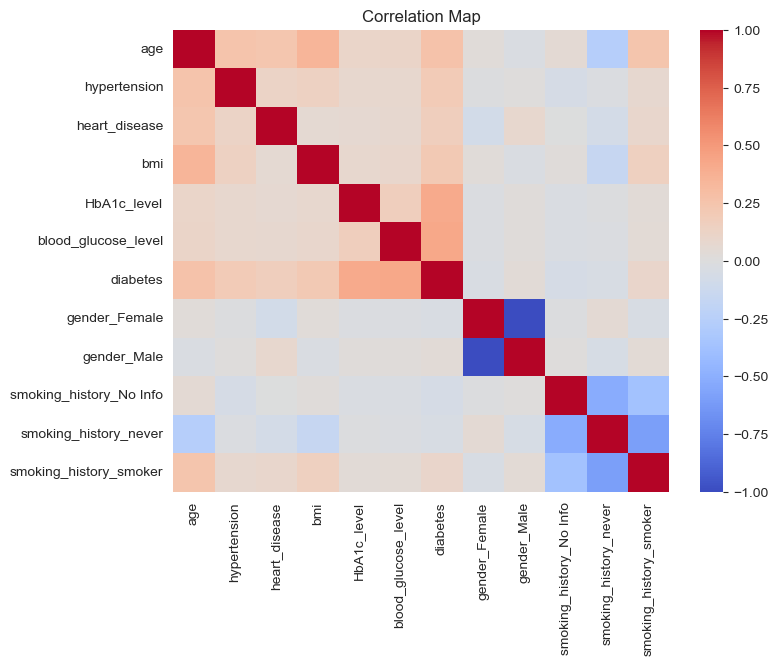

In [42]:


# Compute the correlation matrix
correlation_matrix = df1.corr()

# Create a correlation map using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title('Correlation Map')
plt.show()

### Test feature importance by Decision tree
### Create a base line model  to compare with the models trained after sampling.


In [43]:
df1.shape

(96128, 12)

In [44]:
#Spliting the data :  
X1 = df1.drop('diabetes', axis=1)
y1 = df1.diabetes

X1_train, X1_test, y1_train, y1_test = split(X1, y1, 
                                        train_size=0.75, 
                                        test_size=0.25,
                                        shuffle=True,
                                        stratify=df1.diabetes)


In [45]:
X1.shape

(96128, 11)

In [46]:
#instanciation & fit
dt_model1 = DecisionTreeClassifier(max_depth=8, min_samples_leaf=10).fit(X1_train, y1_train)

In [47]:
#Inspecting the model 
dt_model1.classes_



array([0, 1], dtype=int64)

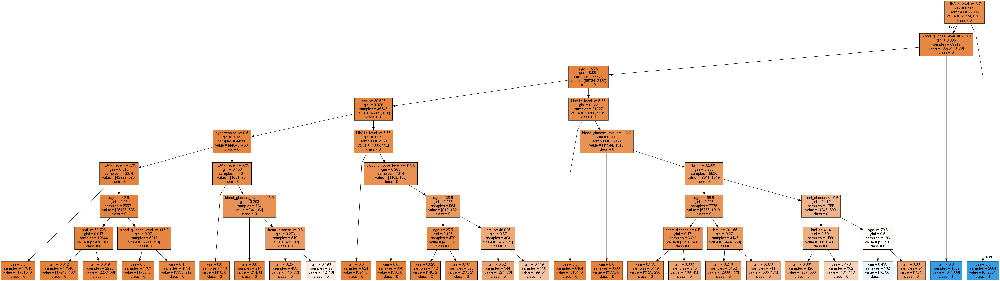

In [48]:
#Visualization: 
dot_data = StringIO()

export_graphviz(dt_model1, out_file=dot_data, feature_names=X1.columns.astype(str),
                leaves_parallel=True, filled=True, class_names=['0','1'])
graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]
Image(graph.create_png(), width=1000)




<Axes: title={'center': 'Feature importances'}>

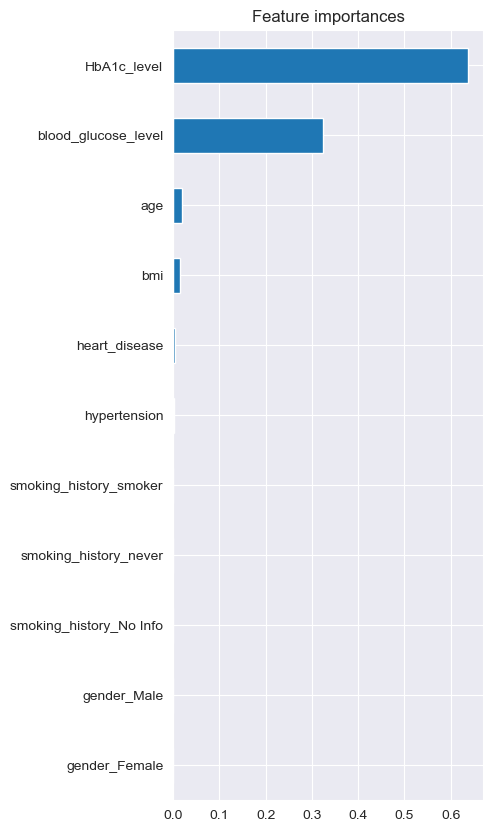

In [49]:
#Feature importance
pd.Series(dt_model1.feature_importances_, index=X1_train.columns).sort_values()\
    .plot.barh(figsize=(4, 10), rot=0, title='Feature importances')


In [50]:
#Feature importance
pd.Series(dt_model1.feature_importances_, index=X1_train.columns).sort_values(ascending=False)

HbA1c_level                0.638367
blood_glucose_level        0.324627
age                        0.017958
bmi                        0.014614
heart_disease              0.003301
hypertension               0.001132
gender_Female              0.000000
gender_Male                0.000000
smoking_history_No Info    0.000000
smoking_history_never      0.000000
smoking_history_smoker     0.000000
dtype: float64

In [51]:
#Assessing the model : First we apply the classification model to the (training) data.
df2=df1.copy()
df2['target_pred'] = dt_model1.predict(X1)
df2.head(6)


,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes,gender_Female,gender_Male,smoking_history_No Info,smoking_history_never,smoking_history_smoker,target_pred
0,80.0,0,1,25.19,6.6,140,0,1,0,0,1,0,0
1,54.0,0,0,27.32,6.6,80,0,1,0,1,0,0,0
2,28.0,0,0,27.32,5.7,158,0,0,1,0,1,0,0
3,36.0,0,0,23.45,5.0,155,0,1,0,0,0,1,0
4,76.0,1,1,20.14,4.8,155,0,0,1,0,0,1,0
5,20.0,0,0,27.32,6.6,85,0,1,0,0,1,0,0


In [52]:
#Validation
#confusion matrix
cm = confusion_matrix(y_true=y1,
                      y_pred=df2.target_pred)
pd.DataFrame(cm,
             index=dt_model1.classes_,
             columns=dt_model1.classes_)
# We didn't treated the imbalanced data and we mistake a lot in the positive ( underrepresented target) - make sence


,0,1
0,87545,101
1,2699,5783


In [53]:
#classification report _ train 
print(classification_report(y_true=y1,
                            y_pred=df2.target_pred))


              precision    recall  f1-score   support

           0       0.97      1.00      0.98     87646
           1       0.98      0.68      0.81      8482

    accuracy                           0.97     96128
   macro avg       0.98      0.84      0.89     96128
weighted avg       0.97      0.97      0.97     96128



In [54]:
#classification report _ test
y_pred = dt_model1.predict(X1_test)

# Generate the classification report
report = classification_report(y1_test, y_pred)
print("Classification Report:")
print(report)

Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     21912
           1       0.98      0.70      0.81      2120

    accuracy                           0.97     24032
   macro avg       0.98      0.85      0.90     24032
weighted avg       0.97      0.97      0.97     24032



In [55]:
y_train_pred = pd.DataFrame(dt_model1.predict_proba(X1_train), 
                            columns=dt_model1.classes_)
log_loss(y1_train, y_train_pred)



0.08781216823828661

In [56]:
y_test_pred = pd.DataFrame(dt_model1.predict_proba(X1_test), 
                        columns=dt_model1.classes_)
log_loss(y1_test, y_test_pred)


0.08404794576228475

### Based on feature importance we will run cross validation to see if smoking history, gender and heart disease can be removed.

In [57]:
# Perform cross-validation using Decision tree classifier and scoring as recall
k=5
scores = cross_val_score(dt_model1, X1_train, y1_train, cv=k, scoring='recall')
print("Scores : " + (k * "{:.3f} ").format(*scores))
scores.mean(), scores.std()

Scores : 0.650 0.672 0.667 0.667 0.694 


(0.6700716872440182, 0.013884506998264224)

#### Now we remove the features one by one to see their impact on the prdiction

In [58]:
print(X1_train.shape)
print(y1_train.shape)
print(X1_train.columns)

(72096, 11)
(72096,)
Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'gender_Female', 'gender_Male',
       'smoking_history_No Info', 'smoking_history_never',
       'smoking_history_smoker'],
      dtype='object')


In [59]:
X1_train

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,gender_Female,gender_Male,smoking_history_No Info,smoking_history_never,smoking_history_smoker
85787,69.0,0,0,27.32,6.5,90,0,1,1,0,0
69819,80.0,0,0,28.01,5.8,140,1,0,0,1,0
93951,55.0,0,0,28.69,5.0,155,1,0,1,0,0
83466,64.0,0,0,24.62,6.1,145,1,0,0,0,1
50732,29.0,0,0,27.32,6.2,200,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
74570,52.0,0,0,20.28,5.7,155,1,0,0,1,0
43215,7.0,0,0,14.63,6.1,90,0,1,0,1,0
70512,57.0,0,0,22.38,6.2,126,0,1,0,1,0
19883,45.0,0,0,25.49,4.5,100,1,0,0,0,1


In [60]:
# Create a list to store the results
results = []

# Iterate over each feature name
for feature_name in X1_train.columns:
    # Create a copy of X_train
    X_train_updated = X1_train.copy()
    
    # Remove the current feature from X_train_updated
    X_train_updated.drop(columns=feature_name, inplace=True)

    # Create a new decision tree model
    dt_model = DecisionTreeClassifier(max_depth=8, min_samples_leaf=8)

    # Perform cross-validation using the updated X_train
    scores = cross_val_score(dt_model, X_train_updated, y1_train, cv=5, scoring='recall')

    # Calculate mean and standard deviation of scores
    scores_mean = scores.mean()
    scores_std = scores.std()

    # Store the results
    results.append({
        'Removed Feature': feature_name,
        'Mean': scores_mean,
        'Std': scores_std
    })

# Create a DataFrame from the results
df_results = pd.DataFrame(results)

# Display the DataFrame
df_results









,Removed Feature,Mean,Std
0,age,0.673374,0.015977
1,hypertension,0.668972,0.012074
2,heart_disease,0.670073,0.017857
3,bmi,0.663942,0.015238
4,HbA1c_level,0.401917,0.005770
5,blood_glucose_level,0.475796,0.012781
6,gender_Female,0.670072,0.013885
7,gender_Male,0.670072,0.013885
8,smoking_history_No Info,0.670072,0.013885
9,smoking_history_never,0.670072,0.013885


In [61]:
#Add a row with all features cross validation
new_row = {'Removed Feature': 'all', 'Mean': 0.679027, 'Std': 0.006925}

# Create a new DataFrame by concatenating the new row with the existing DataFrame
df_results = pd.concat([pd.DataFrame(new_row, index=[0]), df_results]).reset_index(drop=True)

# Display the updated DataFrame
df_results

,Removed Feature,Mean,Std
0,all,0.679027,0.006925
1,age,0.673374,0.015977
2,hypertension,0.668972,0.012074
3,heart_disease,0.670073,0.017857
4,bmi,0.663942,0.015238
5,HbA1c_level,0.401917,0.005770
6,blood_glucose_level,0.475796,0.012781
7,gender_Female,0.670072,0.013885
8,gender_Male,0.670072,0.013885
9,smoking_history_No Info,0.670072,0.013885


#### Since the following features (gender female and male, smoking history smoker and never) show no importance both in cross validation and feature importance, we will remove them

In [62]:
# remove the features with no importance
print(df1.columns, df1.shape)
df3=df1.drop(['gender_Female', 'gender_Male', 'smoking_history_never','smoking_history_smoker','smoking_history_No Info'],axis=1)
print(df3.columns, df3.shape)

Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes', 'gender_Female', 'gender_Male',
       'smoking_history_No Info', 'smoking_history_never',
       'smoking_history_smoker'],
      dtype='object') (96128, 12)
Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'blood_glucose_level', 'diabetes'],
      dtype='object') (96128, 7)


#### Split the new data df3

In [63]:

X = df3.drop('diabetes', axis=1)
y = df3.diabetes

X_train, X_test, y_train, y_test = split(X, y, 
                                        train_size=0.75, 
                                        test_size=0.25,
                                        shuffle=True,
                                        stratify=df3.diabetes)


In [64]:
print(X.shape)
print(y.shape)
print(X_train.shape)


(96128, 6)
(96128,)
(72096, 6)


#### Cross validation to df3 

In [65]:

# Perform cross-validation using Decision tree classifier and scoring as recall
k=5
scores = cross_val_score(dt_model, X_train, y_train, cv=k, scoring='recall')
print("Scores : " + (k * "{:.3f} ").format(*scores))
scores.mean(), scores.std()

Scores : 0.667 0.677 0.700 0.682 0.680 


(0.6812347152025375, 0.01090573841697871)

### Imbalanced data- work only with train

In [66]:
from collections import Counter
counter = Counter(y_train)
print(counter) 


y_train.value_counts()
# The data is imbalanced the ratio is 1:10

Counter({0: 65734, 1: 6362})


0    65734
1     6362
Name: diabetes, dtype: int64

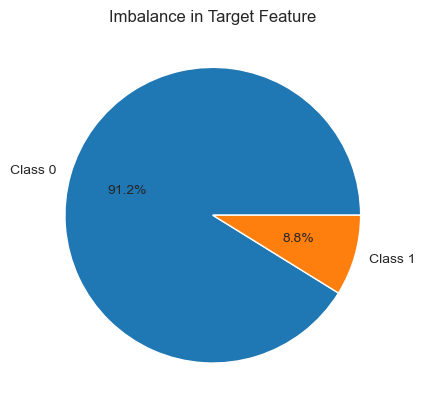

In [67]:
# Count the number of instances for each class
class_0_count = len(y_train[y == 0])
class_1_count = len(y_train[y == 1])

# Create labels for the classes
class_labels = ['Class 0', 'Class 1']

# Create the pie chart
plt.pie([class_0_count, class_1_count], labels=class_labels, autopct='%1.1f%%')

# Set title
plt.title('Imbalance in Target Feature')

# Show the plot
plt.show()








##### Let's try 25% :75%

In [68]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# Define the desired oversampling ratio for class 1
oversampling_ratio_class1 = {1: 12724, 0: 65734}

# Define the desired undersampling ratio for class 0
undersampling_ratio_class0 = {1: 12724, 0: 38172}

# Create the SMOTE oversampler for class 1
smote = SMOTE(sampling_strategy=oversampling_ratio_class1)

# Apply SMOTE to oversample class 1
X_oversampled1, y_oversampled1 = smote.fit_resample(X_train, y_train)

# Create the RandomUnderSampler for class 0
rus = RandomUnderSampler(sampling_strategy=undersampling_ratio_class0)

# Apply RandomUnderSampler to undersample class 0
X1_resampled, y1_resampled = rus.fit_resample(X_oversampled1, y_oversampled1)

print(X1_resampled.shape, y1_resampled.shape)

(50896, 6) (50896,)


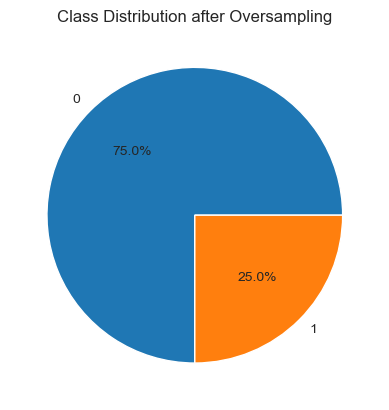

In [69]:
#Visualize the result

# Count the number of samples in each class
class_counts = y1_resampled.value_counts()

# Get the class labels
class_labels = class_counts.index

# Create a pie chart
plt.pie(class_counts, labels=class_labels, autopct='%1.1f%%')

# Add a title
plt.title('Class Distribution after Oversampling')

# Display the chart
plt.show()

##### Let's also try 30% : 70%

In [70]:

# Define the desired oversampling ratio for class 1
oversampling_ratio_class1 = {1: 12724, 0: 65734}

# Define the desired undersampling ratio for class 0
undersampling_ratio_class0 = {1: 12724, 0: 29689}

# Create the SMOTE oversampler for class 1
smote = SMOTE(sampling_strategy=oversampling_ratio_class1)

# Apply SMOTE to oversample class 1
X_oversampled, y_oversampled = smote.fit_resample(X_train, y_train)

# Create the RandomUnderSampler for class 0
rus = RandomUnderSampler(sampling_strategy=undersampling_ratio_class0)

# Apply RandomUnderSampler to undersample class 0
X_resampled, y_resampled = rus.fit_resample(X_oversampled, y_oversampled)

print(X_resampled.shape, y_resampled.shape)

(42413, 6) (42413,)


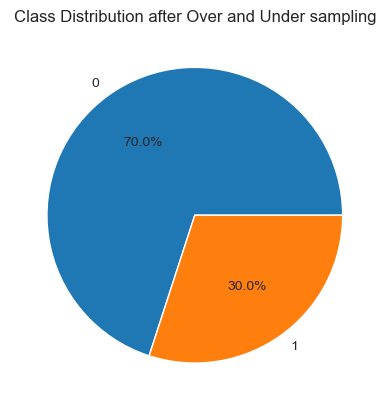

In [71]:
#Visualize the result

# Count the number of samples in each class
class_counts = y_resampled.value_counts()

# Get the class labels
class_labels = class_counts.index

# Create a pie chart
plt.pie(class_counts, labels=class_labels, autopct='%1.1f%%')

# Add a title
plt.title('Class Distribution after Over and Under sampling')

# Display the chart
plt.show()

### Our TRAIN data is now X_resampled, y_resampled
### Lets run cross validation  again

In [72]:
# 75%:25%
k=5
scores = cross_val_score(dt_model, X1_resampled, y1_resampled, cv=k, scoring='recall')
print("Scores : " + (k * "{:.3f} ").format(*scores))
scores.mean(), scores.std()

Scores : 0.794 0.806 0.795 0.776 0.771 


(0.7885898790327563, 0.013001784743344952)

In [73]:
#70%:30%
k=5
scores = cross_val_score(dt_model, X_resampled, y_resampled, cv=k, scoring='recall')
print("Scores : " + (k * "{:.3f} ").format(*scores))
scores.mean(), scores.std()

Scores : 0.807 0.825 0.782 0.813 0.789 


(0.8029715436606493, 0.015758024279902683)

The higher is the % of the positive class(1) the better is the recall

### Apply Penalizing to further improve the balance between classes

In [74]:
X_resampled

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level
0,53.000000,0,0,29.340000,6.600000,159
1,15.000000,0,0,27.210000,5.800000,90
2,55.000000,0,0,17.100000,6.600000,155
3,74.000000,0,0,22.560000,3.500000,145
4,2.000000,0,0,18.620000,6.200000,90
...,...,...,...,...,...,...
42408,62.000000,0,0,33.482884,5.781857,160
42409,80.000000,0,1,43.120000,5.700000,140
42410,71.470737,0,0,23.852419,6.011705,240
42411,61.204349,0,0,28.549651,6.465654,240


In [75]:
dt_model=DecisionTreeClassifier(max_depth=8, min_samples_leaf=10, class_weight='balanced').fit(X_resampled, y_resampled)

In [76]:
k=5
scores = cross_val_score(dt_model, X_resampled, y_resampled, cv=k, scoring='recall')
print("Scores : " + (k * "{:.3f} ").format(*scores))
scores.mean(), scores.std()

Scores : 0.922 0.927 0.923 0.934 0.901 


(0.9213307323522507, 0.010790356591980943)

[0 1]


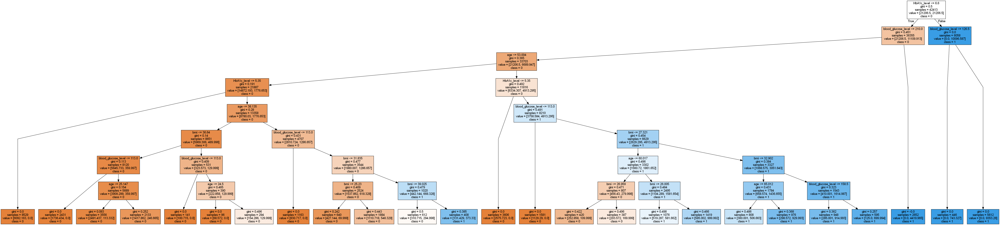

In [77]:
#Decisin tree

#Inspecting the model 
print(dt_model.classes_)

#Visualization: 

dot_data = StringIO()
export_graphviz(dt_model, out_file=dot_data, feature_names=X_resampled.columns.astype(str),
                leaves_parallel=True, filled=True, class_names=['0','1'])
graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]
Image(graph.create_png(), width=1000)




In [78]:
#Assessing the model : First we apply the classification model to the (training) data.
pred=X_resampled.copy()
pred['target_pred'] = dt_model.predict(X_resampled)
pred.head()

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,target_pred
0,53.0,0,0,29.34,6.6,159,0
1,15.0,0,0,27.21,5.8,90,0
2,55.0,0,0,17.10,6.6,155,0
3,74.0,0,0,22.56,3.5,145,0
4,2.0,0,0,18.62,6.2,90,0


In [79]:
#Validation
#confusion matrix
cm = confusion_matrix(y_true=y_resampled,
                      y_pred=pred.target_pred)
pd.DataFrame(cm,
             index=dt_model.classes_,
             columns=dt_model.classes_)

,0,1
0,26463,3226
1,1010,11714


In [80]:
#classification report_train 
print(classification_report(y_true=y_resampled,
                            y_pred=pred.target_pred))

              precision    recall  f1-score   support

           0       0.96      0.89      0.93     29689
           1       0.78      0.92      0.85     12724

    accuracy                           0.90     42413
   macro avg       0.87      0.91      0.89     42413
weighted avg       0.91      0.90      0.90     42413



In [81]:
#classification report _ test
y_pred = dt_model.predict(X_test)

# Generate the classification report
report = classification_report(y_test, y_pred)
print("Classification Report:")
print(report)

Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.89      0.94     21912
           1       0.45      0.90      0.60      2120

    accuracy                           0.89     24032
   macro avg       0.72      0.90      0.77     24032
weighted avg       0.94      0.89      0.91     24032



In [82]:
#Validation
y_train_pred = pd.DataFrame(dt_model.predict_proba(X_resampled), 
                            columns=dt_model.classes_)
log_loss(y_resampled, y_train_pred)


0.18514133044157244

In [83]:
y_test_pred = pd.DataFrame(dt_model.predict_proba(X_test), 
                        columns=dt_model.classes_)
log_loss(y_test, y_test_pred)

0.18565266835198763

### Let's apply grid search to find best HP for decision tree

In [84]:
from sklearn.model_selection import  GridSearchCV
my_param_grid = [{'max_depth':range(8,20), 'min_samples_leaf': [6,7,8,9,10], 'class_weight': ['balanced']}]

#define frod search and fit it
clf_gs = GridSearchCV(dt_model, my_param_grid, scoring='recall', cv=5)
clf_gs.fit(X_resampled, y_resampled)




GridSearchCV(cv=5,
             estimator=DecisionTreeClassifier(class_weight='balanced',
                                              max_depth=8,
                                              min_samples_leaf=10),
             param_grid=[{'class_weight': ['balanced'],
                          'max_depth': range(8, 20),
                          'min_samples_leaf': [6, 7, 8, 9, 10]}],
             scoring='recall')

In [85]:
#look at the best values from the specified grid.
print("Best parameters:", clf_gs.best_params_) 

Best parameters: {'class_weight': 'balanced', 'max_depth': 8, 'min_samples_leaf': 6}


In [86]:
print(y_test.shape)
print(y_resampled.shape)

(24032,)
(42413,)


In [87]:
best_estimator = clf_gs.best_estimator_
best_estimator

# Make predictions on the test data using the best estimator
y_pred = clf_gs.predict(X_test)

# Generate the classification report
report = classification_report(y_test, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.99      0.89      0.94     21912
           1       0.45      0.90      0.60      2120

    accuracy                           0.89     24032
   macro avg       0.72      0.90      0.77     24032
weighted avg       0.94      0.89      0.91     24032



In [88]:
#Validation
y_train_pred = pd.DataFrame(clf_gs.predict_proba(X_resampled), 
                            columns=clf_gs.classes_)
log_loss(y_resampled, y_train_pred)



0.18514133044157244

In [89]:
y_test_pred = pd.DataFrame(clf_gs.predict_proba(X_test), 
                        columns=clf_gs.classes_)
log_loss(y_test, y_test_pred)

0.18565266835198763

### Import all pacages for transformers and estimators to be used

In [90]:
from sklearn.pipeline import Pipeline, FeatureUnion, make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import FunctionTransformer
from sklearn.ensemble import AdaBoostClassifier


##### Install xgboost and lightgbm

In [91]:
#pip install xgboost

In [ ]:
#pip install lightgbm

In [92]:
# import XGBoost and LGBMClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

In [93]:
# Our data: 
# Train data
X_res=X_resampled.copy()
y_res=y_resampled.copy()

X_test
y_test
print(X_res.shape, y_res.shape, X_test.shape, y_test.shape)

(42413, 6) (42413,) (24032, 6) (24032,)


### To decide which transformer is better MinMaxScaler or StandardScaler, we build a transformer :

In [94]:
from sklearn.base import BaseEstimator, TransformerMixin, ClassifierMixin

class PandasScaler(BaseEstimator, TransformerMixin):
    def __init__(self, scaling_type, columns):
        self.scaling_type = scaling_type
        self.columns=columns
        if self.scaling_type=='ss':
            self.scaler=StandardScaler()
        else:
            self.scaler=MinMaxScaler()
        
    def fit (self, X, y=None):
        self.scaler.fit(X[self.columns])
        return self

    def transform ( self, X):
        X_new=X.copy()
        scaled_cols=self.scaler.transform(X_new[self.columns])
        X_new.loc[:,self.columns]=scaled_cols
        return X_new


### Now we build an estimator to run several models 

In [96]:

    
class Est(BaseEstimator, ClassifierMixin):
    def __init__(self, hyperparameters=None):
        self.hyperparameters = hyperparameters
        self.models = {}

    def fit(self, X, y):
        self.classes_ = y.unique()
        for cla in self.classes_:
            if cla in self.hyperparameters:
                params = self.hyperparameters[cla]
                if 'dt' in params:
                    self.models[cla] = DecisionTreeClassifier(**params['dt'], class_weight='balanced').fit(X, (y == cla).astype(int))
                elif 'knn' in params:
                    self.models[cla] = KNeighborsClassifier(**params['knn']).fit(X, (y == cla).astype(int))
                elif 'lr' in params:
                    self.models[cla] = LogisticRegression(**params['lr'], class_weight='balanced').fit(X, (y == cla).astype(int))
                elif 'rf' in params:
                    self.models[cla] = RandomForestClassifier(**params['rf'], class_weight='balanced').fit(X, (y == cla).astype(int))
                elif 'ada' in params:
                    self.models[cla] = AdaBoostClassifier(**params['rf']).fit(X, (y == cla).astype(int))
                elif 'xgbgb' in params:
                    self.models[cla] = XGBClassifier(**params['rf'], class_weight='balanced').fit(X, (y == cla).astype(int))
                elif 'lightb'in params:
                    self.models[cla] = LGBMClassifier(**params['rf'], class_weight='balanced').fit(X, (y == cla).astype(int))
        return self

    def predict(self, X):
        preds = {}
        for cla in self.classes_:
            preds[cla] = self.models[cla].predict_proba(X)[:, 1]
        return pd.DataFrame(preds).idxmax(axis=1)


### Find best combination of transformer and estimator:

In [97]:
# Define the steps of the pipeline
steps = [
    ('scaler', PandasScaler(scaling_type='ss', columns=['age', 'bmi', 'HbA1c_level', 'blood_glucose_level'])),
    ('estimator', Est())
]

# Instantiate the pipeline
pipeline = Pipeline(steps)

# Define the parameter grid for grid search
param_grid = {
    'scaler__scaling_type': ['ss', 'mm'],  # Test both StandardScaler and MinMaxScaler
    'estimator__hyperparameters': [
        {'dt': {'max_depth': 15, 'min_samples_leaf': 9, 'class_weight': 'balanced'}},
        {'knn': {'n_neighbors': 5, 'weigths':'distance'}},
        {'lr': {'class_weight': 'balanced'}},
        {'rf': {'class_weight': 'balanced', 'n_estimators':120, 'max_depth': 10, 'min_samples_split': 9}},
        { 'ada':{'Learning_rate': 0.1, 'algorithm': 'SAMME', 'N_estimators' : 100, 'Base_estimator': DecisionTreeClassifier()}},
        {'xgb':{'Learning_rate': 0.5, 'Max_depth':8 }},
        {'lightb':{'Learning_rate': 0.1,'Max_depth': 6,'Num_leaves' : 11}}
    ]  # Test different hyperparameters for each estimator
}

# Instantiate the GridSearchCV
grid_search = GridSearchCV(pipeline, param_grid=param_grid, scoring='recall', cv=5)

# Fit the GridSearch
grid_search.fit(X_res, y_res)

# Get the best parameters and best estimator
grid_search.best_params_


{'estimator__hyperparameters': {'dt': {'max_depth': 15,
   'min_samples_leaf': 9,
   'class_weight': 'balanced'}},
 'scaler__scaling_type': 'ss'}

In [98]:
print(grid_search.best_estimator_)




Pipeline(steps=[('scaler',
                 PandasScaler(columns=['age', 'bmi', 'HbA1c_level',
                                       'blood_glucose_level'],
                              scaling_type='ss')),
                ('estimator',
                 Est(hyperparameters={'dt': {'class_weight': 'balanced',
                                             'max_depth': 15,
                                             'min_samples_leaf': 9}}))])


### Evaluate models on the balanced data one by one and record the scores

In [99]:
print(X_res.shape, y_res.shape)
print(X_test.shape, y_test.shape)

(42413, 6) (42413,)
(24032, 6) (24032,)


In [100]:
from IPython import get_ipython
from time import time
from sklearn.metrics import precision_score, f1_score

# Define dict to store the results: 
results={}

### Logistic regression

In [103]:

#logistic regression ( no need to do grid search or normalize the data)

start_time = time()
logistic = LogisticRegression(class_weight='balanced')
logistic.fit(X_res, y_res)
y_pred = logistic.predict(X_test)
end_time = time()

training_time = end_time - start_time

results['Logistic Regression'] = [precision_score(y_test, y_pred, average='weighted'),
                                  recall(y_test, y_pred, average='weighted'),
                                  f1_score(y_test, y_pred, average='weighted'),
                                  training_time]


print("Execution time lr:", training_time)

# Get the confusion matrix
cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=logistic.classes_,
             columns=logistic.classes_)



NameError: name 'recall' is not defined

### Logistic regression with normalization

In [104]:
#define pipeline

pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('lr', LogisticRegression())
])

lr = LogisticRegression(class_weight='balanced')
lr.fit(X_res, y_res)
y_pred = lr.predict(X_test)

cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=lr.classes_,
             columns=lr.classes_)

# Results are the same as without normalization

,0,1
0,19377,2535
1,271,1849


### knn ( needs both transformer to normalize data and grid search for best k) - apply pipeline

In [105]:
#KNN
#define pipeline
start_time = time()
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('knn', KNeighborsClassifier())
])

# Define the parameter grid for grid search
param_grid = {
    'knn__n_neighbors': range(5,40) ,  # Test different values for n_neighbors
    'knn__weights': ['uniform', 'distance'],  # Test different weight options
}

# Instantiate the GridSearchCV
grid_search = GridSearchCV(pipeline, param_grid=param_grid, scoring='recall')

# Fit the GridSearchCV on train data
grid_search.fit(X_res, y_res)

# Access the best parameters and best score
best_params = grid_search.best_params_
print(best_params)

y_pred = grid_search.predict(X_test)

end_time = time()
training_time = end_time - start_time

results['K-Nearest Neighbors (KNN)'] = [precision_score(y_test, y_pred, average='weighted'),
                                        recall_score(y_test, y_pred, average='weighted'),
                                       f1_score(y_test, y_pred, average='weighted'),
                                       training_time]
print("Execution time knn:", training_time)

# Get the confusion matrix
cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=grid_search.classes_,
             columns=grid_search.classes_)


{'knn__n_neighbors': 5, 'knn__weights': 'distance'}


NameError: name 'recall_score' is not defined

### Decision tree ( already did the grid search), no need to normalize data

In [ ]:
#Decision tree
start_time = time()
dt = DecisionTreeClassifier(max_depth=15, min_samples_leaf=9, class_weight='balanced')
dt.fit(X_res, y_res)
y_pred = dt.predict(X_test)
end_time = time()

training_time = end_time - start_time

results['Decision Tree'] = [precision_score(y_test, y_pred, average='weighted'),
                                  recall_score(y_test, y_pred, average='weighted'),
                                  f1_score(y_test, y_pred, average='weighted'),
                                  training_time]

print("Execution time dt:", training_time)

cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=dt.classes_,
             columns=dt.classes_)



### RandomForest (normalization not needed) +grid search

In [ ]:
start_time = time()
# Define the parameter grid for grid search
param_grid = {
    'n_estimators': [100, 120, 140],
    'class_weight': ['balanced'],
    'max_depth': range(6, 20),
    'min_samples_split': range(6, 12)
}

# Instantiate the RandomForestClassifier
rf = RandomForestClassifier()

# Instantiate the GridSearchCV
grid_search = GridSearchCV(rf, param_grid=param_grid, scoring='recall')

# Fit the GridSearchCV on train data
grid_search.fit(X_res, y_res)

print(grid_search.best_params_)

y_pred = grid_search.predict(X_test)
end_time = time()

training_time = end_time - start_time

results['Random Forest'] = [precision_score(y_test, y_pred, average='weighted'),
                            recall_score(y_test, y_pred, average='weighted'),
                            f1_score(y_test, y_pred, average='weighted'),
                            training_time]

print("Execution time rf:", training_time)

cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=grid_search.classes_,
             columns=grid_search.classes_)

###  AdaBoost (Normalization is not nessesary) +grid search

In [ ]:

# AdaBoost
start_time = time()

# Define the parameter grid for grid search
param_grid = {
    'n_estimators': [100, 120, 140],
    'base_estimator': [DecisionTreeClassifier(), LogisticRegression()],
    'learning_rate': [0.1,0.2,0.3,0.5],
    'algorithm':['SAMME']
}
#instantiate the adaboost
ada = AdaBoostClassifier()

#instantiate grid search
gs=GridSearchCV(ada, param_grid=param_grid, scoring='recall')
gs.fit(X_res, y_res)

print(gs.best_params_)
y_pred = gs.predict(X_test)
end_time = time()

training_time = end_time - start_time

results['ada boost'] = [precision_score(y_test, y_pred, average='weighted'),
                                  recall_score(y_test, y_pred, average='weighted'),
                                  f1_score(y_test, y_pred, average='weighted'),
                                  training_time]

print("Execution time ada:", training_time)

cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=gs.classes_,
             columns=gs.classes_)



### XGBoost ( normalization is not nessesary) +grid search

In [ ]:
#XGBoost
start_time = time()
#define grid params
param_grid = {
    'max_depth': range(6,10),
    'class_weight': ['balanced'],
    'learning_rate': [0.1,0.2,0.3,0.5]
}
#instantiate the xgboost
xg = XGBClassifier()

#instantiate grid search
gs=GridSearchCV(xg, param_grid=param_grid, scoring='recall')
gs.fit(X_res, y_res)

print(gs.best_params_)
y_pred = gs.predict(X_test)
end_time = time()

training_time = end_time - start_time

results['XGBoost'] = [precision_score(y_test, y_pred, average='weighted'),
                                  recall_score(y_test, y_pred, average='weighted'),
                                  f1_score(y_test, y_pred, average='weighted'),
                                  training_time]

print("Execution time xg:", training_time)

cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=gs.classes_,
             columns=gs.classes_)


### LightBoost ( normalization is not nessesary) +grid search

In [ ]:
#Light Gradient Boosting Machine (LGBM)
start_time = time()

#define grid params
param_grid = {
    'max_depth': range(6,10),
    'class_weight': ['balanced'],
    'learning_rate': [0.1,0.2,0.3,0.5],
    'num_leaves':range(10,20)
}

#instantiate lightBoost
lgb = LGBMClassifier()

#instantiate grid search
gs=GridSearchCV(lgb, param_grid=param_grid, scoring='recall')
gs.fit(X_res, y_res)

print(gs.best_params_)
y_pred = gs.predict(X_test)
end_time = time()

training_time = end_time - start_time

results['Light GBoost'] = [precision_score(y_test, y_pred, average='weighted'),
                                  recall_score(y_test, y_pred, average='weighted'),
                                  f1_score(y_test, y_pred, average='weighted'),
                                  training_time]

print("Execution time lgb:", training_time)

cm = confusion_matrix(y_test, y_pred)
pd.DataFrame(cm,
             index=gs.classes_,
             columns=gs.classes_)

In [ ]:
# Create a DataFrame from the results
df_results = pd.DataFrame.from_dict(results, orient='index', columns=[ 'Precision', 'Recall', 'F1-Score', 'Training Time'])

df_results

### Now let's create the ROC and PR AUC

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
y = radar.Type
scores = radar_clf.predict_proba(X)[:, 1]
scores  array([0.99945058, 0.85312786, 0.99956557, ..., 0.05024649, 0.32025471, 0.39476809])
fpr, tpr, thresholds = roc_curve(y, scores, pos_label='Plane')
res = pd.DataFrame({'FPR': fpr, 'TPR': tpr, 'Threshold': thresholds})
res[['TPR', 'FPR', 'Threshold']][::100]
